In [61]:
import pandas as pd
import plotly
plotly.offline.init_notebook_mode(connected=True)
from plotly.graph_objs import *
from plotly import tools
import plotly.graph_objects as go
import seaborn as sns
pd.set_option('display.max_columns', None)

In [2]:
arrivals_df = pd.read_csv("./data/modified/arrivals_jfk_mco_ord.csv")
arrivals_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Wheels-on Time,Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Destination Airport
0,UA,01/01/2023,2645,N23721,ORD,23:57,23:47,107,100,-10,23:41,6,0,0,0,0,0,SYR
1,UA,01/02/2023,1998,N802UA,ORD,21:07,20:46,113,89,-21,20:43,3,0,0,0,0,0,SYR
2,UA,01/03/2023,1998,N854UA,ORD,21:07,21:04,113,111,-3,20:58,6,0,0,0,0,0,SYR
3,UA,01/04/2023,1998,N893UA,ORD,21:17,21:31,113,110,14,21:26,5,0,0,0,0,0,SYR
4,UA,01/05/2020,2012,N825UA,ORD,21:47,21:55,107,94,8,21:50,5,0,0,0,0,0,SYR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,3149,N462WN,MCO,13:00,13:08,160,147,8,13:05,3,0,0,0,0,0,SYR
17460,WN,12/29/2023,3149,N551WN,MCO,13:00,12:46,160,150,-14,12:43,3,0,0,0,0,0,SYR
17461,WN,12/30/2023,3208,N283WN,MCO,12:30,12:23,160,157,-7,12:14,9,0,0,0,0,0,SYR
17462,WN,12/31/2022,1149,N7734H,MCO,14:05,14:12,160,147,7,14:10,2,0,0,0,0,0,SYR


In [3]:
arrivals_df.loc[5409]

Carrier Code                                        B6
Date (MM/DD/YYYY)                           08/28/2022
Flight Number                                     2516
Tail Number                                     N236JB
Origin Airport                                     JFK
Scheduled Arrival Time                           00:13
Actual Arrival Time                              24:00
Scheduled Elapsed Time (Minutes)                    74
Actual Elapsed Time (Minutes)                       66
Arrival Delay (Minutes)                            -13
Wheels-on Time                                   23:56
Taxi-In time (Minutes)                               4
Delay Carrier (Minutes)                              0
Delay Weather (Minutes)                              0
Delay National Aviation System (Minutes)             0
Delay Security (Minutes)                             0
Delay Late Aircraft Arrival (Minutes)                0
Destination Airport                                SYR
Name: 5409

In [5]:
arrivals_df["Actual Arrival Time"] = arrivals_df["Actual Arrival Time"].apply(lambda x: "00"+x[2:] if x[:2]=="24" else x)
arrivals_df["scheduled_arrival_time"] = arrivals_df["Date (MM/DD/YYYY)"] + ' '+ arrivals_df["Scheduled Arrival Time"]
arrivals_df["actual_arrival_time"] = arrivals_df["Date (MM/DD/YYYY)"] + ' ' + arrivals_df["Actual Arrival Time"]
arrivals_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Wheels-on Time,Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Destination Airport,scheduled_arrival_time,actual_arrival_time
0,UA,01/01/2023,2645,N23721,ORD,23:57,23:47,107,100,-10,23:41,6,0,0,0,0,0,SYR,01/01/2023 23:57,01/01/2023 23:47
1,UA,01/02/2023,1998,N802UA,ORD,21:07,20:46,113,89,-21,20:43,3,0,0,0,0,0,SYR,01/02/2023 21:07,01/02/2023 20:46
2,UA,01/03/2023,1998,N854UA,ORD,21:07,21:04,113,111,-3,20:58,6,0,0,0,0,0,SYR,01/03/2023 21:07,01/03/2023 21:04
3,UA,01/04/2023,1998,N893UA,ORD,21:17,21:31,113,110,14,21:26,5,0,0,0,0,0,SYR,01/04/2023 21:17,01/04/2023 21:31
4,UA,01/05/2020,2012,N825UA,ORD,21:47,21:55,107,94,8,21:50,5,0,0,0,0,0,SYR,01/05/2020 21:47,01/05/2020 21:55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,3149,N462WN,MCO,13:00,13:08,160,147,8,13:05,3,0,0,0,0,0,SYR,12/28/2023 13:00,12/28/2023 13:08
17460,WN,12/29/2023,3149,N551WN,MCO,13:00,12:46,160,150,-14,12:43,3,0,0,0,0,0,SYR,12/29/2023 13:00,12/29/2023 12:46
17461,WN,12/30/2023,3208,N283WN,MCO,12:30,12:23,160,157,-7,12:14,9,0,0,0,0,0,SYR,12/30/2023 12:30,12/30/2023 12:23
17462,WN,12/31/2022,1149,N7734H,MCO,14:05,14:12,160,147,7,14:10,2,0,0,0,0,0,SYR,12/31/2022 14:05,12/31/2022 14:12


In [6]:
arrivals_df["scheduled_arrival_time"] = pd.to_datetime(arrivals_df["scheduled_arrival_time"], format="%m/%d/%Y %H:%M")
arrivals_df["actual_arrival_time"] = pd.to_datetime(arrivals_df["actual_arrival_time"], format="%m/%d/%Y %H:%M")
arrivals_df["date"] = arrivals_df["actual_arrival_time"].dt.date
arrivals_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Wheels-on Time,Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Destination Airport,scheduled_arrival_time,actual_arrival_time,date
0,UA,01/01/2023,2645,N23721,ORD,23:57,23:47,107,100,-10,23:41,6,0,0,0,0,0,SYR,2023-01-01 23:57:00,2023-01-01 23:47:00,2023-01-01
1,UA,01/02/2023,1998,N802UA,ORD,21:07,20:46,113,89,-21,20:43,3,0,0,0,0,0,SYR,2023-01-02 21:07:00,2023-01-02 20:46:00,2023-01-02
2,UA,01/03/2023,1998,N854UA,ORD,21:07,21:04,113,111,-3,20:58,6,0,0,0,0,0,SYR,2023-01-03 21:07:00,2023-01-03 21:04:00,2023-01-03
3,UA,01/04/2023,1998,N893UA,ORD,21:17,21:31,113,110,14,21:26,5,0,0,0,0,0,SYR,2023-01-04 21:17:00,2023-01-04 21:31:00,2023-01-04
4,UA,01/05/2020,2012,N825UA,ORD,21:47,21:55,107,94,8,21:50,5,0,0,0,0,0,SYR,2020-01-05 21:47:00,2020-01-05 21:55:00,2020-01-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,3149,N462WN,MCO,13:00,13:08,160,147,8,13:05,3,0,0,0,0,0,SYR,2023-12-28 13:00:00,2023-12-28 13:08:00,2023-12-28
17460,WN,12/29/2023,3149,N551WN,MCO,13:00,12:46,160,150,-14,12:43,3,0,0,0,0,0,SYR,2023-12-29 13:00:00,2023-12-29 12:46:00,2023-12-29
17461,WN,12/30/2023,3208,N283WN,MCO,12:30,12:23,160,157,-7,12:14,9,0,0,0,0,0,SYR,2023-12-30 12:30:00,2023-12-30 12:23:00,2023-12-30
17462,WN,12/31/2022,1149,N7734H,MCO,14:05,14:12,160,147,7,14:10,2,0,0,0,0,0,SYR,2022-12-31 14:05:00,2022-12-31 14:12:00,2022-12-31


In [7]:
arrivals_df.loc[5409]

Carrier Code                                                 B6
Date (MM/DD/YYYY)                                    08/28/2022
Flight Number                                              2516
Tail Number                                              N236JB
Origin Airport                                              JFK
Scheduled Arrival Time                                    00:13
Actual Arrival Time                                       00:00
Scheduled Elapsed Time (Minutes)                             74
Actual Elapsed Time (Minutes)                                66
Arrival Delay (Minutes)                                     -13
Wheels-on Time                                            23:56
Taxi-In time (Minutes)                                        4
Delay Carrier (Minutes)                                       0
Delay Weather (Minutes)                                       0
Delay National Aviation System (Minutes)                      0
Delay Security (Minutes)                

In [59]:
a_corr = arrivals_df.corr(numeric_only=True)
a_corr_ = a_corr.abs().unstack().sort_values(ascending=False).drop_duplicates()
a_corr_pairs = a_corr[a_corr>0.1]

<Axes: >

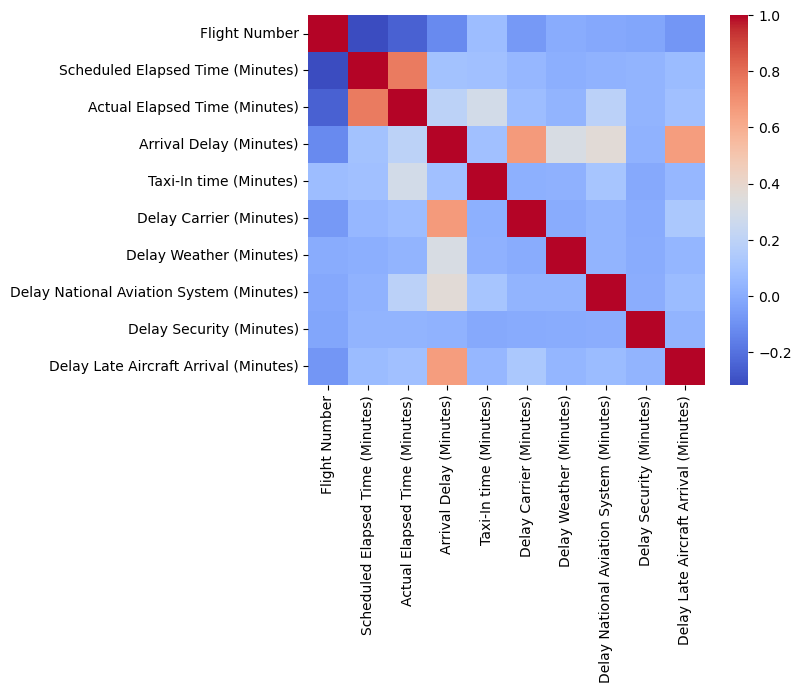

In [62]:
sns.heatmap(a_corr, cmap='coolwarm')

In [9]:
a_corr_columns = set()
for pair in a_corr_pairs.index:
    a_corr_columns.add(pair[0])
    a_corr_columns.add(pair[1])
a_corr_columns

{'Actual Elapsed Time (Minutes)',
 'Arrival Delay (Minutes)',
 'Delay Carrier (Minutes)',
 'Delay Late Aircraft Arrival (Minutes)',
 'Delay National Aviation System (Minutes)',
 'Delay Weather (Minutes)',
 'Flight Number',
 'Scheduled Elapsed Time (Minutes)',
 'Taxi-In time (Minutes)'}

In [10]:
a_cat_cols = arrivals_df.select_dtypes(include=['object'])
a_cat_cols

,Carrier Code,Date (MM/DD/YYYY),Tail Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Wheels-on Time,Destination Airport,date
0,UA,01/01/2023,N23721,ORD,23:57,23:47,23:41,SYR,2023-01-01
1,UA,01/02/2023,N802UA,ORD,21:07,20:46,20:43,SYR,2023-01-02
2,UA,01/03/2023,N854UA,ORD,21:07,21:04,20:58,SYR,2023-01-03
3,UA,01/04/2023,N893UA,ORD,21:17,21:31,21:26,SYR,2023-01-04
4,UA,01/05/2020,N825UA,ORD,21:47,21:55,21:50,SYR,2020-01-05
...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,N462WN,MCO,13:00,13:08,13:05,SYR,2023-12-28
17460,WN,12/29/2023,N551WN,MCO,13:00,12:46,12:43,SYR,2023-12-29
17461,WN,12/30/2023,N283WN,MCO,12:30,12:23,12:14,SYR,2023-12-30
17462,WN,12/31/2022,N7734H,MCO,14:05,14:12,14:10,SYR,2022-12-31


In [11]:
drop_flight_cols = ["Tail Number", "Wheels-on Time", "Destination Airport"]

In [12]:
arrivals_df.drop(columns=drop_flight_cols, inplace=True)

In [13]:
arrivals_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date
0,UA,01/01/2023,2645,ORD,23:57,23:47,107,100,-10,6,0,0,0,0,0,2023-01-01 23:57:00,2023-01-01 23:47:00,2023-01-01
1,UA,01/02/2023,1998,ORD,21:07,20:46,113,89,-21,3,0,0,0,0,0,2023-01-02 21:07:00,2023-01-02 20:46:00,2023-01-02
2,UA,01/03/2023,1998,ORD,21:07,21:04,113,111,-3,6,0,0,0,0,0,2023-01-03 21:07:00,2023-01-03 21:04:00,2023-01-03
3,UA,01/04/2023,1998,ORD,21:17,21:31,113,110,14,5,0,0,0,0,0,2023-01-04 21:17:00,2023-01-04 21:31:00,2023-01-04
4,UA,01/05/2020,2012,ORD,21:47,21:55,107,94,8,5,0,0,0,0,0,2020-01-05 21:47:00,2020-01-05 21:55:00,2020-01-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,3149,MCO,13:00,13:08,160,147,8,3,0,0,0,0,0,2023-12-28 13:00:00,2023-12-28 13:08:00,2023-12-28
17460,WN,12/29/2023,3149,MCO,13:00,12:46,160,150,-14,3,0,0,0,0,0,2023-12-29 13:00:00,2023-12-29 12:46:00,2023-12-29
17461,WN,12/30/2023,3208,MCO,12:30,12:23,160,157,-7,9,0,0,0,0,0,2023-12-30 12:30:00,2023-12-30 12:23:00,2023-12-30
17462,WN,12/31/2022,1149,MCO,14:05,14:12,160,147,7,2,0,0,0,0,0,2022-12-31 14:05:00,2022-12-31 14:12:00,2022-12-31


In [14]:
arrivals_df.groupby(["Origin Airport", "Carrier Code"]).agg(count=('date', 'size'), 
    min_date=('date', 'min'), 
    max_date=('date', 'max'))

count    min_date    max_date
Origin Airport Carrier Code                               
JFK            9E             3731  2019-01-01  2023-12-31
               B6             2719  2019-01-01  2023-12-31
               OO                1  2021-05-10  2021-05-10
               YX              168  2019-01-01  2023-06-25
MCO            B6             1465  2019-01-01  2023-12-31
               F9             1060  2019-01-01  2023-12-31
               WN              182  2021-11-20  2023-12-31
ORD            AA              279  2019-04-02  2020-04-05
               EV               20  2019-01-13  2019-12-15
               F9               77  2019-04-30  2019-11-12
               MQ             2419  2019-01-01  2023-12-31
               OO             2347  2019-01-01  2023-12-20
               UA             1640  2019-01-07  2023-12-31
               YX             1356  2019-01-01  2023-12-31

In [15]:
departures_df = pd.read_csv("./data/modified/departures_jfk_mco_ord.csv")
departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Wheels-off time,Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport
0,9E,01/01/2019,5391,N8943A,SYR,10:05,09:53,82,96,-12,10:13,20,0,0,0,0,0,JFK
1,9E,01/01/2020,5066,N980EV,SYR,10:05,09:51,92,72,-14,10:11,20,0,0,0,0,0,JFK
2,9E,01/01/2021,4851,N296PQ,SYR,17:29,17:21,76,68,-8,17:41,20,0,0,0,0,0,JFK
3,9E,01/01/2023,5190,N325PQ,SYR,21:10,21:05,91,68,-5,21:23,18,0,0,0,0,0,JFK
4,9E,01/02/2019,5391,N840AY,SYR,10:05,09:56,83,92,-9,10:27,31,0,0,0,0,0,JFK
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17458,F9,12/30/2023,3792,N341FR,SYR,16:35,16:28,171,178,-7,16:53,25,0,0,0,0,0,MCO
17459,F9,12/31/2020,1214,N232FR,SYR,14:15,14:10,176,157,-5,14:23,13,0,0,0,0,0,MCO
17460,F9,12/31/2021,1214,N347FR,SYR,17:01,16:56,166,169,-5,17:15,19,0,0,0,0,0,MCO
17461,F9,12/31/2022,1216,N235FR,SYR,07:55,07:48,169,144,-7,08:04,16,0,0,0,0,0,MCO


In [16]:
departures_df["Actual departure time"] = departures_df["Actual departure time"].apply(lambda x: "00"+x[2:] if x[:2]=="24" else x)
departures_df["scheduled_departure_time"] = departures_df["Date (MM/DD/YYYY)"] + ' '+ departures_df["Scheduled departure time"]
departures_df["actual_departure_time"] = departures_df["Date (MM/DD/YYYY)"] + ' ' + departures_df["Actual departure time"]
departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Wheels-off time,Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time
0,9E,01/01/2019,5391,N8943A,SYR,10:05,09:53,82,96,-12,10:13,20,0,0,0,0,0,JFK,01/01/2019 10:05,01/01/2019 09:53
1,9E,01/01/2020,5066,N980EV,SYR,10:05,09:51,92,72,-14,10:11,20,0,0,0,0,0,JFK,01/01/2020 10:05,01/01/2020 09:51
2,9E,01/01/2021,4851,N296PQ,SYR,17:29,17:21,76,68,-8,17:41,20,0,0,0,0,0,JFK,01/01/2021 17:29,01/01/2021 17:21
3,9E,01/01/2023,5190,N325PQ,SYR,21:10,21:05,91,68,-5,21:23,18,0,0,0,0,0,JFK,01/01/2023 21:10,01/01/2023 21:05
4,9E,01/02/2019,5391,N840AY,SYR,10:05,09:56,83,92,-9,10:27,31,0,0,0,0,0,JFK,01/02/2019 10:05,01/02/2019 09:56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17458,F9,12/30/2023,3792,N341FR,SYR,16:35,16:28,171,178,-7,16:53,25,0,0,0,0,0,MCO,12/30/2023 16:35,12/30/2023 16:28
17459,F9,12/31/2020,1214,N232FR,SYR,14:15,14:10,176,157,-5,14:23,13,0,0,0,0,0,MCO,12/31/2020 14:15,12/31/2020 14:10
17460,F9,12/31/2021,1214,N347FR,SYR,17:01,16:56,166,169,-5,17:15,19,0,0,0,0,0,MCO,12/31/2021 17:01,12/31/2021 16:56
17461,F9,12/31/2022,1216,N235FR,SYR,07:55,07:48,169,144,-7,08:04,16,0,0,0,0,0,MCO,12/31/2022 07:55,12/31/2022 07:48


In [17]:
departures_df["scheduled_departure_time"] = pd.to_datetime(departures_df["scheduled_departure_time"], format="%m/%d/%Y %H:%M")
departures_df["actual_departure_time"] = pd.to_datetime(departures_df["actual_departure_time"], format="%m/%d/%Y %H:%M")
departures_df["date"] = departures_df["actual_departure_time"].dt.date
departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Wheels-off time,Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date
0,9E,01/01/2019,5391,N8943A,SYR,10:05,09:53,82,96,-12,10:13,20,0,0,0,0,0,JFK,2019-01-01 10:05:00,2019-01-01 09:53:00,2019-01-01
1,9E,01/01/2020,5066,N980EV,SYR,10:05,09:51,92,72,-14,10:11,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01
2,9E,01/01/2021,4851,N296PQ,SYR,17:29,17:21,76,68,-8,17:41,20,0,0,0,0,0,JFK,2021-01-01 17:29:00,2021-01-01 17:21:00,2021-01-01
3,9E,01/01/2023,5190,N325PQ,SYR,21:10,21:05,91,68,-5,21:23,18,0,0,0,0,0,JFK,2023-01-01 21:10:00,2023-01-01 21:05:00,2023-01-01
4,9E,01/02/2019,5391,N840AY,SYR,10:05,09:56,83,92,-9,10:27,31,0,0,0,0,0,JFK,2019-01-02 10:05:00,2019-01-02 09:56:00,2019-01-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17458,F9,12/30/2023,3792,N341FR,SYR,16:35,16:28,171,178,-7,16:53,25,0,0,0,0,0,MCO,2023-12-30 16:35:00,2023-12-30 16:28:00,2023-12-30
17459,F9,12/31/2020,1214,N232FR,SYR,14:15,14:10,176,157,-5,14:23,13,0,0,0,0,0,MCO,2020-12-31 14:15:00,2020-12-31 14:10:00,2020-12-31
17460,F9,12/31/2021,1214,N347FR,SYR,17:01,16:56,166,169,-5,17:15,19,0,0,0,0,0,MCO,2021-12-31 17:01:00,2021-12-31 16:56:00,2021-12-31
17461,F9,12/31/2022,1216,N235FR,SYR,07:55,07:48,169,144,-7,08:04,16,0,0,0,0,0,MCO,2022-12-31 07:55:00,2022-12-31 07:48:00,2022-12-31


In [18]:
departures_df[(departures_df["Date (MM/DD/YYYY)"] == "07/26/2023") & (departures_df["Carrier Code"] == "MQ") & (departures_df["Flight Number"] == 3402)]

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Tail Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Wheels-off time,Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date
11052,MQ,07/26/2023,3402,N769KW,SYR,18:36,20:15,116,0,99,20:37,22,0,0,0,0,0,ORD,2023-07-26 18:36:00,2023-07-26 20:15:00,2023-07-26


In [19]:
arrivals_df[(arrivals_df["Date (MM/DD/YYYY)"] == "07/26/2023") & (arrivals_df["Carrier Code"] == "MQ") & (arrivals_df["Flight Number"] == 3402)]

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date
11774,MQ,07/26/2023,3402,ORD,21:32,02:31,116,0,0,6,0,0,0,0,0,2023-07-26 21:32:00,2023-07-26 02:31:00,2023-07-26


In [20]:
departures_df.drop(columns=["Tail Number", "Wheels-off time"], inplace=True)

In [21]:
departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date
0,9E,01/01/2019,5391,SYR,10:05,09:53,82,96,-12,20,0,0,0,0,0,JFK,2019-01-01 10:05:00,2019-01-01 09:53:00,2019-01-01
1,9E,01/01/2020,5066,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01
2,9E,01/01/2021,4851,SYR,17:29,17:21,76,68,-8,20,0,0,0,0,0,JFK,2021-01-01 17:29:00,2021-01-01 17:21:00,2021-01-01
3,9E,01/01/2023,5190,SYR,21:10,21:05,91,68,-5,18,0,0,0,0,0,JFK,2023-01-01 21:10:00,2023-01-01 21:05:00,2023-01-01
4,9E,01/02/2019,5391,SYR,10:05,09:56,83,92,-9,31,0,0,0,0,0,JFK,2019-01-02 10:05:00,2019-01-02 09:56:00,2019-01-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17458,F9,12/30/2023,3792,SYR,16:35,16:28,171,178,-7,25,0,0,0,0,0,MCO,2023-12-30 16:35:00,2023-12-30 16:28:00,2023-12-30
17459,F9,12/31/2020,1214,SYR,14:15,14:10,176,157,-5,13,0,0,0,0,0,MCO,2020-12-31 14:15:00,2020-12-31 14:10:00,2020-12-31
17460,F9,12/31/2021,1214,SYR,17:01,16:56,166,169,-5,19,0,0,0,0,0,MCO,2021-12-31 17:01:00,2021-12-31 16:56:00,2021-12-31
17461,F9,12/31/2022,1216,SYR,07:55,07:48,169,144,-7,16,0,0,0,0,0,MCO,2022-12-31 07:55:00,2022-12-31 07:48:00,2022-12-31


In [22]:
weather_df = pd.read_csv("./data/modified/weather_bit_jfk_ord_mco_syr.csv")
weather_df

,app_temp,azimuth,clouds,dewpt,dhi,dni,elev_angle,ghi,pod,precip_rate,pres,revision_status,rh,slp,snow_rate,solar_rad,temp,timestamp_local,timestamp_utc,ts,uv,vis,weather.description,weather.code,weather.icon,wind_dir,wind_gust_spd,wind_spd,key
0,13.3,308.5,0,7.1,0,0,-81.6,0,n,0.0,1015,final,66,1018,0.0,0,13.3,2020-01-01T00:00:00,2020-01-01T05:00:00,1577854800,0.0,16,Clear Sky,800,c01n,260,3.2,2.10,MCO
1,13.2,245.0,6,7.2,0,0,-81.5,0,n,0.0,1015,final,67,1018,0.0,0,13.2,2020-01-01T00:15:00,2020-01-01T05:15:00,1577855700,0.0,16,Few clouds,801,c02n,265,3.2,2.22,MCO
2,13.1,181.5,12,7.5,0,0,-81.4,0,n,0.0,1014,final,69,1018,0.0,0,13.1,2020-01-01T00:30:00,2020-01-01T05:30:00,1577856600,0.0,16,Few clouds,801,c02n,270,3.2,2.35,MCO
3,12.9,118.0,18,7.6,0,0,-81.2,0,n,0.0,1014,final,70,1018,0.0,0,12.9,2020-01-01T00:45:00,2020-01-01T05:45:00,1577857500,0.0,16,Few clouds,801,c02n,275,3.2,2.47,MCO
4,12.8,54.5,25,7.7,0,0,-81.1,0,n,0.0,1014,final,71,1018,0.0,0,12.8,2020-01-01T01:00:00,2020-01-01T06:00:00,1577858400,0.0,16,Scattered clouds,802,c02n,280,3.2,2.60,MCO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598635,6.2,318.7,0,-1.2,0,0,-30.1,0,n,0.0,1006,interim,56,1021,0.0,0,7.0,2024-04-07T22:45:00,2024-04-08T02:45:00,1712544300,0.0,16,Clear Sky,800,c01n,20,1.6,1.54,SYR
598636,6.9,322.3,42,-2.2,0,0,-32.0,0,n,0.0,1006,interim,52,1022,0.0,0,7.0,2024-04-07T23:00:00,2024-04-08T03:00:00,1712545200,0.0,16,Broken clouds,803,c03n,0,1.0,1.00,SYR
598637,5.0,326.5,42,-4.2,0,0,-33.3,0,n,0.0,1006,interim,48,1022,0.0,0,6.0,2024-04-07T23:15:00,2024-04-08T03:15:00,1712546100,0.0,16,Broken clouds,803,c03n,210,1.6,1.54,SYR
598638,5.8,330.7,42,-2.1,0,0,-34.7,0,n,0.0,1007,interim,56,1022,0.0,0,6.0,2024-04-07T23:30:00,2024-04-08T03:30:00,1712547000,0.0,16,Broken clouds,803,c03n,0,1.0,1.00,SYR


In [23]:
weather_df.isna().sum()

app_temp               0
azimuth                0
clouds                 0
dewpt                  0
dhi                    0
dni                    0
elev_angle             0
ghi                    0
pod                    0
precip_rate            0
pres                   0
revision_status        0
rh                     0
slp                    0
snow_rate              0
solar_rad              0
temp                   0
timestamp_local        0
timestamp_utc          0
ts                     0
uv                     0
vis                    0
weather.description    0
weather.code           0
weather.icon           0
wind_dir               0
wind_gust_spd          0
wind_spd               0
key                    0
dtype: int64

In [24]:
len(weather_df.columns)

29

In [25]:

weather_factors = ['app_temp', 'clouds', 'dewpt', 'pres', 'rh', 'temp', 'timestamp_local', 'uv', 'vis','weather.code', 'wind_dir', 'wind_gust_spd', 'wind_spd', 'key']


In [26]:
weather_df = weather_df[weather_factors]
weather_df

,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key
0,13.3,0,7.1,1015,66,13.3,2020-01-01T00:00:00,0.0,16,800,260,3.2,2.10,MCO
1,13.2,6,7.2,1015,67,13.2,2020-01-01T00:15:00,0.0,16,801,265,3.2,2.22,MCO
2,13.1,12,7.5,1014,69,13.1,2020-01-01T00:30:00,0.0,16,801,270,3.2,2.35,MCO
3,12.9,18,7.6,1014,70,12.9,2020-01-01T00:45:00,0.0,16,801,275,3.2,2.47,MCO
4,12.8,25,7.7,1014,71,12.8,2020-01-01T01:00:00,0.0,16,802,280,3.2,2.60,MCO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598635,6.2,0,-1.2,1006,56,7.0,2024-04-07T22:45:00,0.0,16,800,20,1.6,1.54,SYR
598636,6.9,42,-2.2,1006,52,7.0,2024-04-07T23:00:00,0.0,16,803,0,1.0,1.00,SYR
598637,5.0,42,-4.2,1006,48,6.0,2024-04-07T23:15:00,0.0,16,803,210,1.6,1.54,SYR
598638,5.8,42,-2.1,1007,56,6.0,2024-04-07T23:30:00,0.0,16,803,0,1.0,1.00,SYR


In [27]:
w_corr = weather_df.corr(numeric_only=True)

<Axes: >

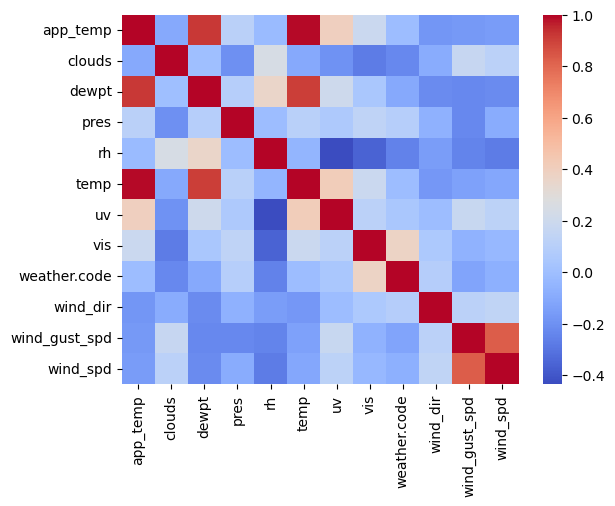

In [63]:
sns.heatmap(w_corr, cmap='coolwarm')

In [29]:
w_corr_pairs = w_corr.unstack().abs().sort_values(ascending=False).drop_duplicates().head(40)
w_corr_pairs


app_temp       app_temp         1.000000
               temp             0.993913
               dewpt            0.917476
dewpt          temp             0.910160
wind_spd       wind_gust_spd    0.830245
uv             rh               0.435545
               temp             0.412373
app_temp       uv               0.398048
weather.code   vis              0.372571
vis            rh               0.362630
dewpt          rh               0.360233
wind_spd       rh               0.277432
vis            clouds           0.276583
weather.code   rh               0.254474
rh             wind_gust_spd    0.249908
clouds         rh               0.246031
wind_gust_spd  pres             0.232760
clouds         weather.code     0.230762
wind_gust_spd  dewpt            0.228199
wind_dir       dewpt            0.221387
dewpt          wind_spd         0.218933
pres           clouds           0.200194
uv             dewpt            0.198266
               clouds           0.195818
vis            t

In [30]:
w_corr_columns = set()
for pair in w_corr_pairs.index:
    w_corr_columns.add(pair[0])
    w_corr_columns.add(pair[1])
w_corr_columns

{'app_temp',
 'clouds',
 'dewpt',
 'pres',
 'rh',
 'temp',
 'uv',
 'vis',
 'weather.code',
 'wind_dir',
 'wind_gust_spd',
 'wind_spd'}

In [32]:
w_cat_cols = weather_df.select_dtypes(exclude=['number'])
w_cat_cols

,timestamp_local,key
0,2020-01-01T00:00:00,MCO
1,2020-01-01T00:15:00,MCO
2,2020-01-01T00:30:00,MCO
3,2020-01-01T00:45:00,MCO
4,2020-01-01T01:00:00,MCO
...,...,...
598635,2024-04-07T22:45:00,SYR
598636,2024-04-07T23:00:00,SYR
598637,2024-04-07T23:15:00,SYR
598638,2024-04-07T23:30:00,SYR


In [33]:
weather_df["timestamp_local"] = pd.to_datetime(weather_df["timestamp_local"])
weather_df

/var/folders/d0/d8qgs1qn1x5dwdq_9zy4q3rm0000gn/T/ipykernel_79814/3651278870.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weather_df["timestamp_local"] = pd.to_datetime(weather_df["timestamp_local"])


,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key
0,13.3,0,7.1,1015,66,13.3,2020-01-01 00:00:00,0.0,16,800,260,3.2,2.10,MCO
1,13.2,6,7.2,1015,67,13.2,2020-01-01 00:15:00,0.0,16,801,265,3.2,2.22,MCO
2,13.1,12,7.5,1014,69,13.1,2020-01-01 00:30:00,0.0,16,801,270,3.2,2.35,MCO
3,12.9,18,7.6,1014,70,12.9,2020-01-01 00:45:00,0.0,16,801,275,3.2,2.47,MCO
4,12.8,25,7.7,1014,71,12.8,2020-01-01 01:00:00,0.0,16,802,280,3.2,2.60,MCO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598635,6.2,0,-1.2,1006,56,7.0,2024-04-07 22:45:00,0.0,16,800,20,1.6,1.54,SYR
598636,6.9,42,-2.2,1006,52,7.0,2024-04-07 23:00:00,0.0,16,803,0,1.0,1.00,SYR
598637,5.0,42,-4.2,1006,48,6.0,2024-04-07 23:15:00,0.0,16,803,210,1.6,1.54,SYR
598638,5.8,42,-2.1,1007,56,6.0,2024-04-07 23:30:00,0.0,16,803,0,1.0,1.00,SYR


In [34]:
syr_df = weather_df[(weather_df["key"]=="SYR") & (weather_df["timestamp_local"]< pd.Timestamp("2024-01-01"))].reset_index(drop=True).sort_values("timestamp_local")
jfk_df = weather_df[(weather_df["key"]=="JFK") & (weather_df["timestamp_local"]< pd.Timestamp("2024-01-01"))].reset_index(drop=True).sort_values("timestamp_local")
mco_df = weather_df[(weather_df["key"]=="MCO") & (weather_df["timestamp_local"]< pd.Timestamp("2024-01-01"))].reset_index(drop=True).sort_values("timestamp_local")
ord_df = weather_df[(weather_df["key"]=="ORD") & (weather_df["timestamp_local"]< pd.Timestamp("2024-01-01"))].reset_index(drop=True).sort_values("timestamp_local")
syr_df
jfk_df
mco_df
ord_df

,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key
0,-8.9,25,-6.3,984,84,-4.0,2020-01-01 00:00:00,0.0,16,802,270,6.4,3.60,ORD
1,-9.0,25,-6.4,984,84,-4.2,2020-01-01 00:15:00,0.0,16,802,270,6.4,3.60,ORD
2,-9.2,25,-6.6,984,84,-4.3,2020-01-01 00:30:00,0.0,16,802,270,6.4,3.60,ORD
3,-9.4,25,-6.8,984,83,-4.4,2020-01-01 00:45:00,0.0,16,802,270,6.4,3.60,ORD
4,-9.3,25,-6.8,984,84,-4.5,2020-01-01 01:00:00,0.0,16,802,270,6.4,3.35,ORD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140251,-5.2,100,-3.0,995,77,0.6,2023-12-31 22:45:00,0.0,16,804,330,10.8,7.20,ORD
140252,-5.3,100,-2.9,995,78,0.4,2023-12-31 23:00:00,0.0,16,804,330,10.8,6.82,ORD
140253,-5.3,100,-2.9,995,79,0.3,2023-12-31 23:15:00,0.0,16,804,330,10.6,6.45,ORD
140254,-5.3,100,-2.9,996,80,0.1,2023-12-31 23:30:00,0.0,16,804,330,10.4,6.07,ORD


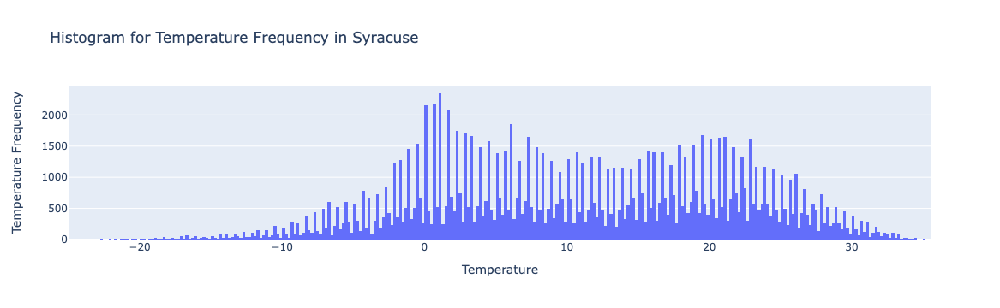

In [68]:
trace = go.Histogram(x=syr_df["temp"])
layout = go.Layout(title='Histogram for Temperature Frequency in Syracuse', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

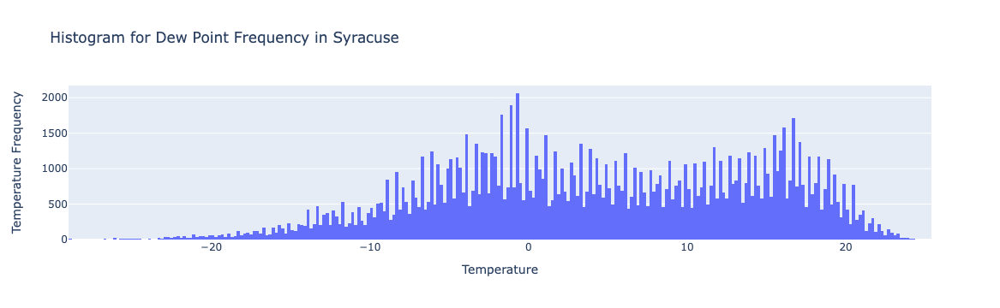

In [69]:
trace = go.Histogram(x=syr_df["dewpt"])
layout = go.Layout(title='Histogram for Dew Point Frequency in Syracuse', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

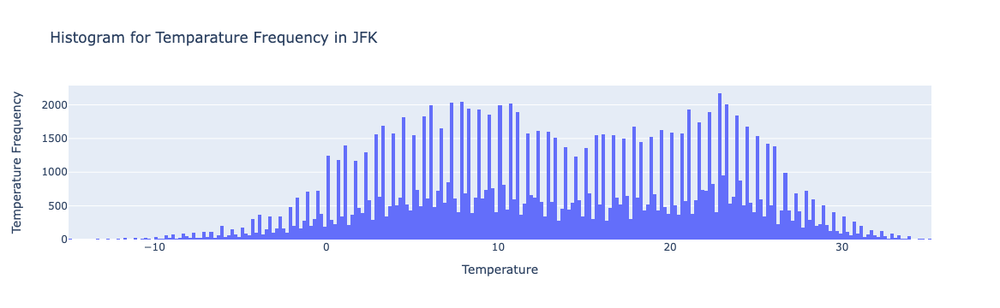

In [70]:
trace = go.Histogram(x=jfk_df["temp"])
layout = go.Layout(title='Histogram for Temparature Frequency in JFK', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

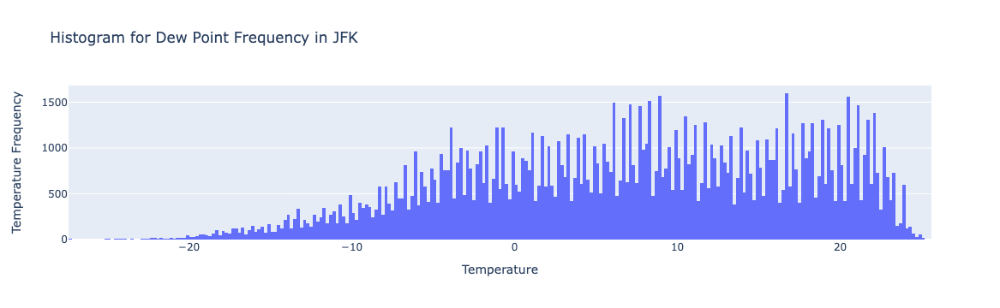

In [71]:
trace = go.Histogram(x=jfk_df["dewpt"])
layout = go.Layout(title='Histogram for Dew Point Frequency in JFK', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

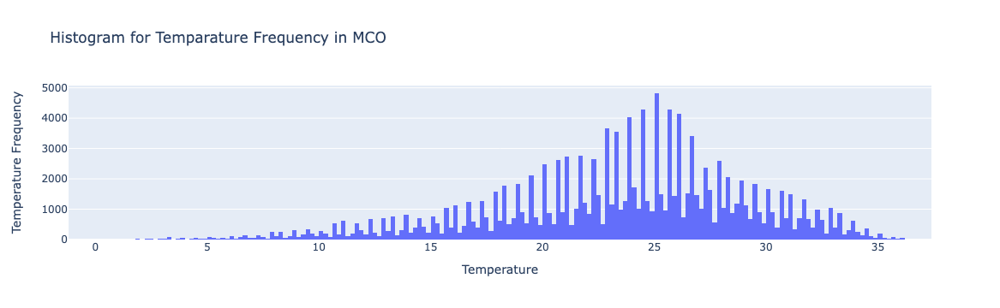

In [74]:
trace = go.Histogram(x=mco_df["temp"])
layout = go.Layout(title='Histogram for Temparature Frequency in MCO', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

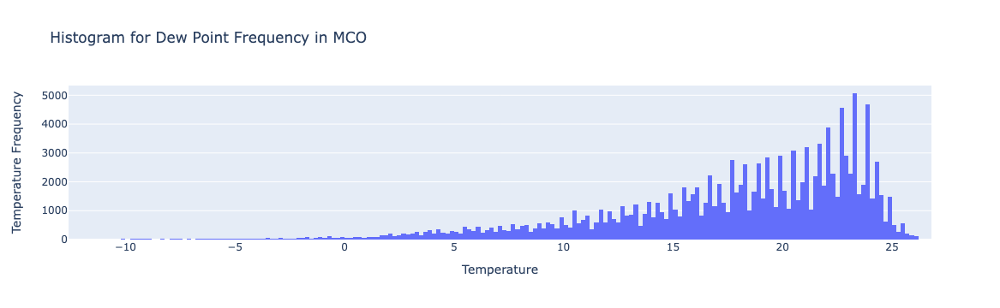

In [75]:
trace = go.Histogram(x=mco_df["dewpt"])
layout = go.Layout(title='Histogram for Dew Point Frequency in MCO', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

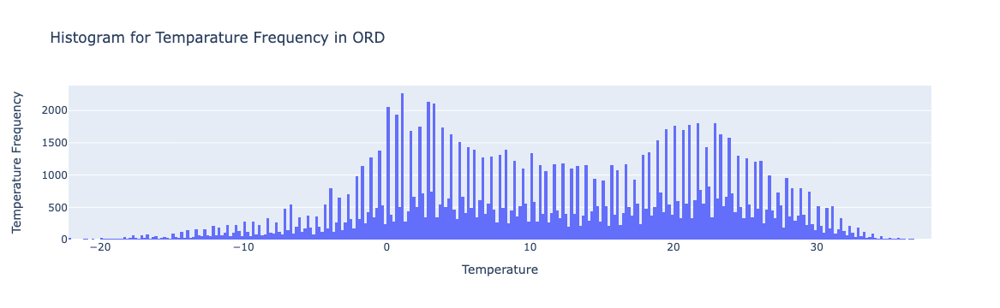

In [72]:
trace = go.Histogram(x=ord_df["temp"])
layout = go.Layout(title='Histogram for Temparature Frequency in ORD', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

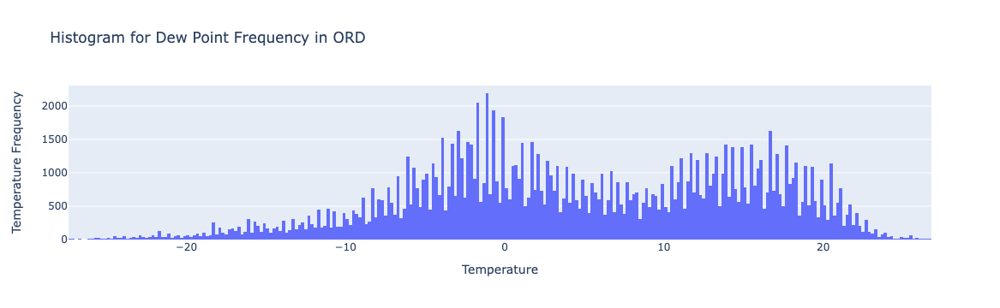

In [73]:
trace = go.Histogram(x=ord_df["dewpt"])
layout = go.Layout(title='Histogram for Dew Point Frequency in ORD', 
                   xaxis=dict(title='Temperature'), yaxis=dict(title='Temperature Frequency'))
fig = go.Figure(data=[trace], layout=layout)
fig.show()

In [35]:
syr_df["date_time_map"] = pd.to_datetime(syr_df["timestamp_local"])
jfk_df["date_time_map"] = pd.to_datetime(jfk_df["timestamp_local"])
mco_df["date_time_map"] = pd.to_datetime(mco_df["timestamp_local"])
ord_df["date_time_map"] = pd.to_datetime(ord_df["timestamp_local"])
syr_df
jfk_df
mco_df
ord_df

,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,-8.9,25,-6.3,984,84,-4.0,2020-01-01 00:00:00,0.0,16,802,270,6.4,3.60,ORD,2020-01-01 00:00:00
1,-9.0,25,-6.4,984,84,-4.2,2020-01-01 00:15:00,0.0,16,802,270,6.4,3.60,ORD,2020-01-01 00:15:00
2,-9.2,25,-6.6,984,84,-4.3,2020-01-01 00:30:00,0.0,16,802,270,6.4,3.60,ORD,2020-01-01 00:30:00
3,-9.4,25,-6.8,984,83,-4.4,2020-01-01 00:45:00,0.0,16,802,270,6.4,3.60,ORD,2020-01-01 00:45:00
4,-9.3,25,-6.8,984,84,-4.5,2020-01-01 01:00:00,0.0,16,802,270,6.4,3.35,ORD,2020-01-01 01:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140251,-5.2,100,-3.0,995,77,0.6,2023-12-31 22:45:00,0.0,16,804,330,10.8,7.20,ORD,2023-12-31 22:45:00
140252,-5.3,100,-2.9,995,78,0.4,2023-12-31 23:00:00,0.0,16,804,330,10.8,6.82,ORD,2023-12-31 23:00:00
140253,-5.3,100,-2.9,995,79,0.3,2023-12-31 23:15:00,0.0,16,804,330,10.6,6.45,ORD,2023-12-31 23:15:00
140254,-5.3,100,-2.9,996,80,0.1,2023-12-31 23:30:00,0.0,16,804,330,10.4,6.07,ORD,2023-12-31 23:30:00


In [36]:
print(weather_df.shape)
print(jfk_df.shape)
print(mco_df.shape)
print(ord_df.shape)
print(syr_df.shape)

(598640, 14)
(140256, 15)
(140256, 15)
(140256, 15)
(140256, 15)


In [37]:
arrivals_df["date_time"] = pd.to_datetime(arrivals_df["scheduled_arrival_time"])
arrivals_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date,date_time
0,UA,01/01/2023,2645,ORD,23:57,23:47,107,100,-10,6,0,0,0,0,0,2023-01-01 23:57:00,2023-01-01 23:47:00,2023-01-01,2023-01-01 23:57:00
1,UA,01/02/2023,1998,ORD,21:07,20:46,113,89,-21,3,0,0,0,0,0,2023-01-02 21:07:00,2023-01-02 20:46:00,2023-01-02,2023-01-02 21:07:00
2,UA,01/03/2023,1998,ORD,21:07,21:04,113,111,-3,6,0,0,0,0,0,2023-01-03 21:07:00,2023-01-03 21:04:00,2023-01-03,2023-01-03 21:07:00
3,UA,01/04/2023,1998,ORD,21:17,21:31,113,110,14,5,0,0,0,0,0,2023-01-04 21:17:00,2023-01-04 21:31:00,2023-01-04,2023-01-04 21:17:00
4,UA,01/05/2020,2012,ORD,21:47,21:55,107,94,8,5,0,0,0,0,0,2020-01-05 21:47:00,2020-01-05 21:55:00,2020-01-05,2020-01-05 21:47:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17459,WN,12/28/2023,3149,MCO,13:00,13:08,160,147,8,3,0,0,0,0,0,2023-12-28 13:00:00,2023-12-28 13:08:00,2023-12-28,2023-12-28 13:00:00
17460,WN,12/29/2023,3149,MCO,13:00,12:46,160,150,-14,3,0,0,0,0,0,2023-12-29 13:00:00,2023-12-29 12:46:00,2023-12-29,2023-12-29 13:00:00
17461,WN,12/30/2023,3208,MCO,12:30,12:23,160,157,-7,9,0,0,0,0,0,2023-12-30 12:30:00,2023-12-30 12:23:00,2023-12-30,2023-12-30 12:30:00
17462,WN,12/31/2022,1149,MCO,14:05,14:12,160,147,7,2,0,0,0,0,0,2022-12-31 14:05:00,2022-12-31 14:12:00,2022-12-31,2022-12-31 14:05:00


In [38]:
departures_df["date_time"] = pd.to_datetime(departures_df["scheduled_departure_time"])
departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time
0,9E,01/01/2019,5391,SYR,10:05,09:53,82,96,-12,20,0,0,0,0,0,JFK,2019-01-01 10:05:00,2019-01-01 09:53:00,2019-01-01,2019-01-01 10:05:00
1,9E,01/01/2020,5066,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01,2020-01-01 10:05:00
2,9E,01/01/2021,4851,SYR,17:29,17:21,76,68,-8,20,0,0,0,0,0,JFK,2021-01-01 17:29:00,2021-01-01 17:21:00,2021-01-01,2021-01-01 17:29:00
3,9E,01/01/2023,5190,SYR,21:10,21:05,91,68,-5,18,0,0,0,0,0,JFK,2023-01-01 21:10:00,2023-01-01 21:05:00,2023-01-01,2023-01-01 21:10:00
4,9E,01/02/2019,5391,SYR,10:05,09:56,83,92,-9,31,0,0,0,0,0,JFK,2019-01-02 10:05:00,2019-01-02 09:56:00,2019-01-02,2019-01-02 10:05:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17458,F9,12/30/2023,3792,SYR,16:35,16:28,171,178,-7,25,0,0,0,0,0,MCO,2023-12-30 16:35:00,2023-12-30 16:28:00,2023-12-30,2023-12-30 16:35:00
17459,F9,12/31/2020,1214,SYR,14:15,14:10,176,157,-5,13,0,0,0,0,0,MCO,2020-12-31 14:15:00,2020-12-31 14:10:00,2020-12-31,2020-12-31 14:15:00
17460,F9,12/31/2021,1214,SYR,17:01,16:56,166,169,-5,19,0,0,0,0,0,MCO,2021-12-31 17:01:00,2021-12-31 16:56:00,2021-12-31,2021-12-31 17:01:00
17461,F9,12/31/2022,1216,SYR,07:55,07:48,169,144,-7,16,0,0,0,0,0,MCO,2022-12-31 07:55:00,2022-12-31 07:48:00,2022-12-31,2022-12-31 07:55:00


In [39]:
arrivals_df.columns

Index(['Carrier Code', 'Date (MM/DD/YYYY)', 'Flight Number', 'Origin Airport',
       'Scheduled Arrival Time', 'Actual Arrival Time',
       'Scheduled Elapsed Time (Minutes)', 'Actual Elapsed Time (Minutes)',
       'Arrival Delay (Minutes)', 'Taxi-In time (Minutes)',
       'Delay Carrier (Minutes)', 'Delay Weather (Minutes)',
       'Delay National Aviation System (Minutes)', 'Delay Security (Minutes)',
       'Delay Late Aircraft Arrival (Minutes)', 'scheduled_arrival_time',
       'actual_arrival_time', 'date', 'date_time'],
      dtype='object')

In [40]:
departures_df.columns

Index(['Carrier Code', 'Date (MM/DD/YYYY)', 'Flight Number',
       'Destination Airport', 'Scheduled departure time',
       'Actual departure time', 'Scheduled elapsed time (Minutes)',
       'Actual elapsed time (Minutes)', 'Departure delay (Minutes)',
       'Taxi-Out time (Minutes)', 'Delay Carrier (Minutes)',
       'Delay Weather (Minutes)', 'Delay National Aviation System (Minutes)',
       'Delay Security (Minutes)', 'Delay Late Aircraft Arrival (Minutes)',
       'Origin Airport', 'scheduled_departure_time', 'actual_departure_time',
       'date', 'date_time'],
      dtype='object')

In [41]:
syr_df.shape

(140256, 15)

In [44]:
arrivals_df_sub = arrivals_df[arrivals_df["date_time"]>=pd.Timestamp("2020-01-01")].sort_values("date_time").reset_index(drop=True)
arrivals_df_sub

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date,date_time
0,B6,01/01/2020,116,JFK,08:22,08:08,75,62,-14,3,0,0,0,0,0,2020-01-01 08:22:00,2020-01-01 08:08:00,2020-01-01,2020-01-01 08:22:00
1,OO,01/01/2020,3247,ORD,10:43,10:40,113,110,-3,4,0,0,0,0,0,2020-01-01 10:43:00,2020-01-01 10:40:00,2020-01-01,2020-01-01 10:43:00
2,9E,01/01/2020,5066,JFK,11:37,11:03,92,72,-34,5,0,0,0,0,0,2020-01-01 11:37:00,2020-01-01 11:03:00,2020-01-01,2020-01-01 11:37:00
3,F9,01/01/2020,1214,MCO,14:39,14:23,164,156,-16,6,0,0,0,0,0,2020-01-01 14:39:00,2020-01-01 14:23:00,2020-01-01,2020-01-01 14:39:00
4,OO,01/01/2020,3253,ORD,14:43,14:38,113,110,-5,5,0,0,0,0,0,2020-01-01 14:43:00,2020-01-01 14:38:00,2020-01-01,2020-01-01 14:43:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12336,YX,12/31/2023,3719,ORD,16:44,17:18,124,157,34,7,0,0,34,0,0,2023-12-31 16:44:00,2023-12-31 17:18:00,2023-12-31,2023-12-31 16:44:00
12337,MQ,12/31/2023,4091,ORD,17:28,19:10,106,105,102,5,0,34,0,0,68,2023-12-31 17:28:00,2023-12-31 19:10:00,2023-12-31,2023-12-31 17:28:00
12338,B6,12/31/2023,656,MCO,19:27,18:51,175,148,-36,3,0,0,0,0,0,2023-12-31 19:27:00,2023-12-31 18:51:00,2023-12-31,2023-12-31 19:27:00
12339,UA,12/31/2023,1983,ORD,21:09,20:59,114,113,-10,5,0,0,0,0,0,2023-12-31 21:09:00,2023-12-31 20:59:00,2023-12-31,2023-12-31 21:09:00


In [45]:
syr_w_merged_data = pd.merge_asof(arrivals_df_sub.sort_values('date_time'),
                                       syr_df.sort_values('date_time_map'),
                                       left_on='date_time', right_on='date_time_map', direction='nearest')

syr_w_merged_data.head()

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,B6,01/01/2020,116,JFK,08:22,08:08,75,62,-14,3,0,0,0,0,0,2020-01-01 08:22:00,2020-01-01 08:08:00,2020-01-01,2020-01-01 08:22:00,-6.5,100,-6.2,989,65,-0.4,2020-01-01 08:15:00,0.4,16,804,250,12.1,7.07,SYR,2020-01-01 08:15:00
1,OO,01/01/2020,3247,ORD,10:43,10:40,113,110,-3,4,0,0,0,0,0,2020-01-01 10:43:00,2020-01-01 10:40:00,2020-01-01,2020-01-01 10:43:00,-5.0,100,-5.2,990,65,0.6,2020-01-01 10:45:00,0.6,16,804,255,14.9,6.70,SYR,2020-01-01 10:45:00
2,9E,01/01/2020,5066,JFK,11:37,11:03,92,72,-34,5,0,0,0,0,0,2020-01-01 11:37:00,2020-01-01 11:03:00,2020-01-01,2020-01-01 11:37:00,-5.1,100,-5.4,990,63,0.8,2020-01-01 11:30:00,0.6,16,804,265,12.6,7.75,SYR,2020-01-01 11:30:00
3,F9,01/01/2020,1214,MCO,14:39,14:23,164,156,-16,6,0,0,0,0,0,2020-01-01 14:39:00,2020-01-01 14:23:00,2020-01-01,2020-01-01 14:39:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.0,7.32,SYR,2020-01-01 14:45:00
4,OO,01/01/2020,3253,ORD,14:43,14:38,113,110,-5,5,0,0,0,0,0,2020-01-01 14:43:00,2020-01-01 14:38:00,2020-01-01,2020-01-01 14:43:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.0,7.32,SYR,2020-01-01 14:45:00


In [46]:
syr_w_merged_data

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,B6,01/01/2020,116,JFK,08:22,08:08,75,62,-14,3,0,0,0,0,0,2020-01-01 08:22:00,2020-01-01 08:08:00,2020-01-01,2020-01-01 08:22:00,-6.5,100,-6.2,989,65,-0.4,2020-01-01 08:15:00,0.4,16,804,250,12.10,7.07,SYR,2020-01-01 08:15:00
1,OO,01/01/2020,3247,ORD,10:43,10:40,113,110,-3,4,0,0,0,0,0,2020-01-01 10:43:00,2020-01-01 10:40:00,2020-01-01,2020-01-01 10:43:00,-5.0,100,-5.2,990,65,0.6,2020-01-01 10:45:00,0.6,16,804,255,14.90,6.70,SYR,2020-01-01 10:45:00
2,9E,01/01/2020,5066,JFK,11:37,11:03,92,72,-34,5,0,0,0,0,0,2020-01-01 11:37:00,2020-01-01 11:03:00,2020-01-01,2020-01-01 11:37:00,-5.1,100,-5.4,990,63,0.8,2020-01-01 11:30:00,0.6,16,804,265,12.60,7.75,SYR,2020-01-01 11:30:00
3,F9,01/01/2020,1214,MCO,14:39,14:23,164,156,-16,6,0,0,0,0,0,2020-01-01 14:39:00,2020-01-01 14:23:00,2020-01-01,2020-01-01 14:39:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00
4,OO,01/01/2020,3253,ORD,14:43,14:38,113,110,-5,5,0,0,0,0,0,2020-01-01 14:43:00,2020-01-01 14:38:00,2020-01-01,2020-01-01 14:43:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12336,YX,12/31/2023,3719,ORD,16:44,17:18,124,157,34,7,0,0,34,0,0,2023-12-31 16:44:00,2023-12-31 17:18:00,2023-12-31,2023-12-31 16:44:00,-5.3,100,-3.4,992,88,-1.7,2023-12-31 16:45:00,0.0,14,804,270,2.72,2.72,SYR,2023-12-31 16:45:00
12337,MQ,12/31/2023,4091,ORD,17:28,19:10,106,105,102,5,0,34,0,0,68,2023-12-31 17:28:00,2023-12-31 19:10:00,2023-12-31,2023-12-31 17:28:00,-4.5,100,-3.7,991,86,-1.7,2023-12-31 17:30:00,0.0,15,804,355,2.04,2.04,SYR,2023-12-31 17:30:00
12338,B6,12/31/2023,656,MCO,19:27,18:51,175,148,-36,3,0,0,0,0,0,2023-12-31 19:27:00,2023-12-31 18:51:00,2023-12-31,2023-12-31 19:27:00,-3.4,100,-4.0,1000,86,-1.9,2023-12-31 19:30:00,0.0,15,804,360,2.40,1.20,SYR,2023-12-31 19:30:00
12339,UA,12/31/2023,1983,ORD,21:09,20:59,114,113,-10,5,0,0,0,0,0,2023-12-31 21:09:00,2023-12-31 20:59:00,2023-12-31,2023-12-31 21:09:00,-4.3,100,-3.9,1000,88,-2.2,2023-12-31 21:15:00,0.0,16,804,360,3.30,1.50,SYR,2023-12-31 21:15:00


In [47]:
jfk_departures_df = departures_df[departures_df["Origin Airport"]=="JFK"]
jfk_departures_df = jfk_departures_df[jfk_departures_df["date_time"]>=pd.Timestamp("2020-01-01")].sort_values("date_time").reset_index(drop=True)
jfk_departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time
0,B6,01/01/2020,116,SYR,07:07,07:06,75,62,-1,11,0,0,0,0,0,JFK,2020-01-01 07:07:00,2020-01-01 07:06:00,2020-01-01,2020-01-01 07:07:00
1,9E,01/01/2020,5066,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01,2020-01-01 10:05:00
2,YX,01/01/2020,5957,SYR,16:29,16:27,93,68,-2,13,0,0,0,0,0,JFK,2020-01-01 16:29:00,2020-01-01 16:27:00,2020-01-01,2020-01-01 16:29:00
3,B6,01/01/2020,2516,SYR,19:30,19:20,80,71,-10,19,0,0,0,0,0,JFK,2020-01-01 19:30:00,2020-01-01 19:20:00,2020-01-01,2020-01-01 19:30:00
4,B6,01/02/2020,116,SYR,07:07,06:59,75,67,-8,24,0,0,0,0,0,JFK,2020-01-02 07:07:00,2020-01-02 06:59:00,2020-01-02,2020-01-02 07:07:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4822,9E,12/30/2023,4946,SYR,15:50,15:45,98,75,-5,15,0,0,0,0,0,JFK,2023-12-30 15:50:00,2023-12-30 15:45:00,2023-12-30,2023-12-30 15:50:00
4823,9E,12/30/2023,4988,SYR,20:40,20:36,104,74,-4,21,0,0,0,0,0,JFK,2023-12-30 20:40:00,2023-12-30 20:36:00,2023-12-30,2023-12-30 20:40:00
4824,B6,12/30/2023,2516,SYR,22:55,23:42,76,68,47,19,0,0,0,0,39,JFK,2023-12-30 22:55:00,2023-12-30 23:42:00,2023-12-30,2023-12-30 22:55:00
4825,B6,12/31/2023,116,SYR,14:22,14:32,78,61,10,13,0,0,0,0,0,JFK,2023-12-31 14:22:00,2023-12-31 14:32:00,2023-12-31,2023-12-31 14:22:00


In [48]:
jfk_w_merged_data = pd.merge_asof(jfk_departures_df.sort_values('date_time'),
                                       jfk_df.sort_values('date_time_map'),
                                       left_on='date_time', right_on='date_time_map', direction='nearest')

jfk_w_merged_data.head()

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,B6,01/01/2020,116,SYR,07:07,07:06,75,62,-1,11,0,0,0,0,0,JFK,2020-01-01 07:07:00,2020-01-01 07:06:00,2020-01-01,2020-01-01 07:07:00,-2.6,87,-2.3,1005,69,2.8,2020-01-01 07:00:00,0.0,16,804,280,11.1,7.70,JFK,2020-01-01 07:00:00
1,9E,01/01/2020,5066,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01,2020-01-01 10:05:00,-1.2,87,-5.8,1007,49,3.9,2020-01-01 10:00:00,0.7,16,804,270,11.6,7.70,JFK,2020-01-01 10:00:00
2,YX,01/01/2020,5957,SYR,16:29,16:27,93,68,-2,13,0,0,0,0,0,JFK,2020-01-01 16:29:00,2020-01-01 16:27:00,2020-01-01,2020-01-01 16:29:00,-1.8,90,-5.9,1008,50,3.5,2020-01-01 16:30:00,0.5,16,804,275,11.6,8.19,JFK,2020-01-01 16:30:00
3,B6,01/01/2020,2516,SYR,19:30,19:20,80,71,-10,19,0,0,0,0,0,JFK,2020-01-01 19:30:00,2020-01-01 19:20:00,2020-01-01,2020-01-01 19:30:00,-2.5,59,-5.8,1011,53,2.8,2020-01-01 19:30:00,0.0,16,803,275,11.2,7.53,JFK,2020-01-01 19:30:00
4,B6,01/02/2020,116,SYR,07:07,06:59,75,67,-8,24,0,0,0,0,0,JFK,2020-01-02 07:07:00,2020-01-02 06:59:00,2020-01-02,2020-01-02 07:07:00,-4.7,25,-3.4,1014,78,0.0,2020-01-02 07:00:00,0.0,16,802,240,6.8,4.59,JFK,2020-01-02 07:00:00


In [49]:
mco_departures_df = departures_df[departures_df["Origin Airport"]=="MCO"]
mco_departures_df = mco_departures_df[mco_departures_df["date_time"]>=pd.Timestamp("2020-01-01")].sort_values("date_time").reset_index(drop=True)
mco_departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time
0,F9,01/01/2020,1214,SYR,11:55,11:47,164,156,-8,14,0,0,0,0,0,MCO,2020-01-01 11:55:00,2020-01-01 11:47:00,2020-01-01,2020-01-01 11:55:00
1,B6,01/01/2020,656,SYR,19:16,19:14,159,161,-2,18,0,0,0,0,0,MCO,2020-01-01 19:16:00,2020-01-01 19:14:00,2020-01-01,2020-01-01 19:16:00
2,B6,01/02/2020,656,SYR,19:16,19:06,159,150,-10,15,0,0,0,0,0,MCO,2020-01-02 19:16:00,2020-01-02 19:06:00,2020-01-02,2020-01-02 19:16:00
3,F9,01/03/2020,1214,SYR,13:17,13:08,169,149,-9,17,0,0,0,0,0,MCO,2020-01-03 13:17:00,2020-01-03 13:08:00,2020-01-03,2020-01-03 13:17:00
4,B6,01/03/2020,656,SYR,19:16,19:41,159,150,25,21,16,0,0,0,0,MCO,2020-01-03 19:16:00,2020-01-03 19:41:00,2020-01-03,2020-01-03 19:16:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2157,B6,12/30/2023,656,SYR,16:32,16:30,175,154,-2,17,0,0,0,0,0,MCO,2023-12-30 16:32:00,2023-12-30 16:30:00,2023-12-30,2023-12-30 16:32:00
2158,F9,12/30/2023,3792,SYR,16:35,16:28,171,178,-7,25,0,0,0,0,0,MCO,2023-12-30 16:35:00,2023-12-30 16:28:00,2023-12-30,2023-12-30 16:35:00
2159,F9,12/31/2023,3792,SYR,07:30,07:27,172,170,-3,23,0,0,0,0,0,MCO,2023-12-31 07:30:00,2023-12-31 07:27:00,2023-12-31,2023-12-31 07:30:00
2160,WN,12/31/2023,3149,SYR,11:30,11:26,160,152,-4,12,0,0,0,0,0,MCO,2023-12-31 11:30:00,2023-12-31 11:26:00,2023-12-31,2023-12-31 11:30:00


In [50]:
mco_w_merged_data = pd.merge_asof(mco_departures_df.sort_values('date_time'),
                                       mco_df.sort_values('date_time_map'),
                                       left_on='date_time', right_on='date_time_map', direction='nearest')

mco_w_merged_data.head()

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,F9,01/01/2020,1214,SYR,11:55,11:47,164,156,-8,14,0,0,0,0,0,MCO,2020-01-01 11:55:00,2020-01-01 11:47:00,2020-01-01,2020-01-01 11:55:00,18.3,25,2.6,1016,35,18.3,2020-01-01 12:00:00,4.0,16,802,290,5.2,3.10,MCO,2020-01-01 12:00:00
1,B6,01/01/2020,656,SYR,19:16,19:14,159,161,-2,18,0,0,0,0,0,MCO,2020-01-01 19:16:00,2020-01-01 19:14:00,2020-01-01,2020-01-01 19:16:00,16.9,31,5.5,1014,47,16.9,2020-01-01 19:15:00,0.0,16,802,280,2.5,2.02,MCO,2020-01-01 19:15:00
2,B6,01/02/2020,656,SYR,19:16,19:06,159,150,-10,15,0,0,0,0,0,MCO,2020-01-02 19:16:00,2020-01-02 19:06:00,2020-01-02,2020-01-02 19:16:00,21.9,87,15.5,1012,67,21.9,2020-01-02 19:15:00,0.0,16,804,135,4.4,3.47,MCO,2020-01-02 19:15:00
3,F9,01/03/2020,1214,SYR,13:17,13:08,169,149,-9,17,0,0,0,0,0,MCO,2020-01-03 13:17:00,2020-01-03 13:08:00,2020-01-03,2020-01-03 13:17:00,29.8,68,21.1,1012,67,27.8,2020-01-03 13:15:00,2.5,16,803,180,10.0,4.84,MCO,2020-01-03 13:15:00
4,B6,01/03/2020,656,SYR,19:16,19:41,159,150,25,21,16,0,0,0,0,MCO,2020-01-03 19:16:00,2020-01-03 19:41:00,2020-01-03,2020-01-03 19:16:00,23.8,25,19.9,1012,81,23.3,2020-01-03 19:15:00,0.0,16,802,175,3.7,2.70,MCO,2020-01-03 19:15:00


In [51]:
ord_departures_df = departures_df[departures_df["Origin Airport"]=="ORD"]
ord_departures_df = ord_departures_df[ord_departures_df["date_time"]>=pd.Timestamp("2020-01-01")].sort_values("date_time").reset_index(drop=True)
ord_departures_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time
0,OO,01/01/2020,3247,SYR,07:50,07:50,113,110,0,28,0,0,0,0,0,ORD,2020-01-01 07:50:00,2020-01-01 07:50:00,2020-01-01,2020-01-01 07:50:00
1,OO,01/01/2020,3253,SYR,11:50,11:48,113,110,-2,25,0,0,0,0,0,ORD,2020-01-01 11:50:00,2020-01-01 11:48:00,2020-01-01,2020-01-01 11:50:00
2,OO,01/01/2020,3241,SYR,15:00,14:54,112,97,-6,13,0,0,0,0,0,ORD,2020-01-01 15:00:00,2020-01-01 14:54:00,2020-01-01,2020-01-01 15:00:00
3,AA,01/01/2020,2877,SYR,18:54,18:52,109,107,-2,26,0,0,0,0,0,ORD,2020-01-01 18:54:00,2020-01-01 18:52:00,2020-01-01,2020-01-01 18:54:00
4,OO,01/02/2020,5631,SYR,06:30,06:26,108,103,-4,19,0,0,0,0,0,ORD,2020-01-02 06:30:00,2020-01-02 06:26:00,2020-01-02,2020-01-02 06:30:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5346,UA,12/30/2023,783,SYR,21:05,21:29,114,104,24,17,0,0,0,0,0,ORD,2023-12-30 21:05:00,2023-12-30 21:29:00,2023-12-30,2023-12-30 21:05:00
5347,MQ,12/31/2023,4134,SYR,08:25,08:26,114,147,1,57,0,1,33,0,0,ORD,2023-12-31 08:25:00,2023-12-31 08:26:00,2023-12-31,2023-12-31 08:25:00
5348,YX,12/31/2023,3719,SYR,13:40,13:41,124,157,1,58,0,0,34,0,0,ORD,2023-12-31 13:40:00,2023-12-31 13:41:00,2023-12-31,2023-12-31 13:40:00
5349,MQ,12/31/2023,4091,SYR,14:42,16:25,106,105,103,11,0,34,0,0,68,ORD,2023-12-31 14:42:00,2023-12-31 16:25:00,2023-12-31,2023-12-31 14:42:00


In [52]:
ord_w_merged_data = pd.merge_asof(ord_departures_df.sort_values('date_time'),
                                       ord_df.sort_values('date_time_map'),
                                       left_on='date_time', right_on='date_time_map', direction='nearest')

ord_w_merged_data.head()

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,OO,01/01/2020,3247,SYR,07:50,07:50,113,110,0,28,0,0,0,0,0,ORD,2020-01-01 07:50:00,2020-01-01 07:50:00,2020-01-01,2020-01-01 07:50:00,-12.2,25,-7.9,984,87,-6.1,2020-01-01 07:45:00,1.0,16,802,200,6.6,4.59,ORD,2020-01-01 07:45:00
1,OO,01/01/2020,3253,SYR,11:50,11:48,113,110,-2,25,0,0,0,0,0,ORD,2020-01-01 11:50:00,2020-01-01 11:48:00,2020-01-01,2020-01-01 11:50:00,-2.8,25,-5.7,982,58,1.7,2020-01-01 11:45:00,1.8,16,802,200,10.8,5.09,ORD,2020-01-01 11:45:00
2,OO,01/01/2020,3241,SYR,15:00,14:54,112,97,-6,13,0,0,0,0,0,ORD,2020-01-01 15:00:00,2020-01-01 14:54:00,2020-01-01,2020-01-01 15:00:00,0.7,59,-2.6,978,58,5.0,2020-01-01 15:00:00,0.8,16,803,195,12.7,6.45,ORD,2020-01-01 15:00:00
3,AA,01/01/2020,2877,SYR,18:54,18:52,109,107,-2,26,0,0,0,0,0,ORD,2020-01-01 18:54:00,2020-01-01 18:52:00,2020-01-01,2020-01-01 18:54:00,-0.1,87,-0.8,977,68,4.5,2020-01-01 19:00:00,0.0,16,804,190,12.5,7.20,ORD,2020-01-01 19:00:00
4,OO,01/02/2020,5631,SYR,06:30,06:26,108,103,-4,19,0,0,0,0,0,ORD,2020-01-02 06:30:00,2020-01-02 06:26:00,2020-01-02,2020-01-02 06:30:00,-1.5,25,-2.4,976,68,3.0,2020-01-02 06:30:00,0.0,16,802,200,9.4,5.50,ORD,2020-01-02 06:30:00


In [53]:
departures_merged_df = pd.concat([jfk_w_merged_data, mco_w_merged_data, ord_w_merged_data]).sort_values("date_time_map").reset_index(drop=True)
departures_merged_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),Origin Airport,scheduled_departure_time,actual_departure_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,B6,01/01/2020,116,SYR,07:07,07:06,75,62,-1,11,0,0,0,0,0,JFK,2020-01-01 07:07:00,2020-01-01 07:06:00,2020-01-01,2020-01-01 07:07:00,-2.6,87,-2.3,1005,69,2.8,2020-01-01 07:00:00,0.0,16,804,280,11.10,7.70,JFK,2020-01-01 07:00:00
1,OO,01/01/2020,3247,SYR,07:50,07:50,113,110,0,28,0,0,0,0,0,ORD,2020-01-01 07:50:00,2020-01-01 07:50:00,2020-01-01,2020-01-01 07:50:00,-12.2,25,-7.9,984,87,-6.1,2020-01-01 07:45:00,1.0,16,802,200,6.60,4.59,ORD,2020-01-01 07:45:00
2,9E,01/01/2020,5066,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,JFK,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01,2020-01-01 10:05:00,-1.2,87,-5.8,1007,49,3.9,2020-01-01 10:00:00,0.7,16,804,270,11.60,7.70,JFK,2020-01-01 10:00:00
3,OO,01/01/2020,3253,SYR,11:50,11:48,113,110,-2,25,0,0,0,0,0,ORD,2020-01-01 11:50:00,2020-01-01 11:48:00,2020-01-01,2020-01-01 11:50:00,-2.8,25,-5.7,982,58,1.7,2020-01-01 11:45:00,1.8,16,802,200,10.80,5.09,ORD,2020-01-01 11:45:00
4,F9,01/01/2020,1214,SYR,11:55,11:47,164,156,-8,14,0,0,0,0,0,MCO,2020-01-01 11:55:00,2020-01-01 11:47:00,2020-01-01,2020-01-01 11:55:00,18.3,25,2.6,1016,35,18.3,2020-01-01 12:00:00,4.0,16,802,290,5.20,3.10,MCO,2020-01-01 12:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12335,B6,12/31/2023,116,SYR,14:22,14:32,78,61,10,13,0,0,0,0,0,JFK,2023-12-31 14:22:00,2023-12-31 14:32:00,2023-12-31,2023-12-31 14:22:00,1.9,96,-3.5,1013,51,5.8,2023-12-31 14:15:00,0.6,16,804,295,6.90,6.15,JFK,2023-12-31 14:15:00
12336,MQ,12/31/2023,4091,SYR,14:42,16:25,106,105,103,11,0,34,0,0,68,ORD,2023-12-31 14:42:00,2023-12-31 16:25:00,2023-12-31,2023-12-31 14:42:00,-2.3,100,-2.3,989,78,1.1,2023-12-31 14:45:00,0.4,10,804,300,6.60,3.10,ORD,2023-12-31 14:45:00
12337,B6,12/31/2023,656,SYR,16:32,16:23,175,148,-9,14,0,0,0,0,0,MCO,2023-12-31 16:32:00,2023-12-31 16:23:00,2023-12-31,2023-12-31 16:32:00,18.1,80,8.8,1015,52,18.9,2023-12-31 16:30:00,1.0,16,804,305,4.40,4.15,MCO,2023-12-31 16:30:00
12338,UA,12/31/2023,1983,SYR,18:15,18:06,114,113,-9,24,0,0,0,0,0,ORD,2023-12-31 18:15:00,2023-12-31 18:06:00,2023-12-31,2023-12-31 18:15:00,-5.4,87,-2.3,993,82,0.4,2023-12-31 18:15:00,0.0,13,804,315,10.70,7.03,ORD,2023-12-31 18:15:00


In [54]:
syr_w_merged_data

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes),Delay Weather (Minutes),Delay National Aviation System (Minutes),Delay Security (Minutes),Delay Late Aircraft Arrival (Minutes),scheduled_arrival_time,actual_arrival_time,date,date_time,app_temp,clouds,dewpt,pres,rh,temp,timestamp_local,uv,vis,weather.code,wind_dir,wind_gust_spd,wind_spd,key,date_time_map
0,B6,01/01/2020,116,JFK,08:22,08:08,75,62,-14,3,0,0,0,0,0,2020-01-01 08:22:00,2020-01-01 08:08:00,2020-01-01,2020-01-01 08:22:00,-6.5,100,-6.2,989,65,-0.4,2020-01-01 08:15:00,0.4,16,804,250,12.10,7.07,SYR,2020-01-01 08:15:00
1,OO,01/01/2020,3247,ORD,10:43,10:40,113,110,-3,4,0,0,0,0,0,2020-01-01 10:43:00,2020-01-01 10:40:00,2020-01-01,2020-01-01 10:43:00,-5.0,100,-5.2,990,65,0.6,2020-01-01 10:45:00,0.6,16,804,255,14.90,6.70,SYR,2020-01-01 10:45:00
2,9E,01/01/2020,5066,JFK,11:37,11:03,92,72,-34,5,0,0,0,0,0,2020-01-01 11:37:00,2020-01-01 11:03:00,2020-01-01,2020-01-01 11:37:00,-5.1,100,-5.4,990,63,0.8,2020-01-01 11:30:00,0.6,16,804,265,12.60,7.75,SYR,2020-01-01 11:30:00
3,F9,01/01/2020,1214,MCO,14:39,14:23,164,156,-16,6,0,0,0,0,0,2020-01-01 14:39:00,2020-01-01 14:23:00,2020-01-01,2020-01-01 14:39:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00
4,OO,01/01/2020,3253,ORD,14:43,14:38,113,110,-5,5,0,0,0,0,0,2020-01-01 14:43:00,2020-01-01 14:38:00,2020-01-01,2020-01-01 14:43:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12336,YX,12/31/2023,3719,ORD,16:44,17:18,124,157,34,7,0,0,34,0,0,2023-12-31 16:44:00,2023-12-31 17:18:00,2023-12-31,2023-12-31 16:44:00,-5.3,100,-3.4,992,88,-1.7,2023-12-31 16:45:00,0.0,14,804,270,2.72,2.72,SYR,2023-12-31 16:45:00
12337,MQ,12/31/2023,4091,ORD,17:28,19:10,106,105,102,5,0,34,0,0,68,2023-12-31 17:28:00,2023-12-31 19:10:00,2023-12-31,2023-12-31 17:28:00,-4.5,100,-3.7,991,86,-1.7,2023-12-31 17:30:00,0.0,15,804,355,2.04,2.04,SYR,2023-12-31 17:30:00
12338,B6,12/31/2023,656,MCO,19:27,18:51,175,148,-36,3,0,0,0,0,0,2023-12-31 19:27:00,2023-12-31 18:51:00,2023-12-31,2023-12-31 19:27:00,-3.4,100,-4.0,1000,86,-1.9,2023-12-31 19:30:00,0.0,15,804,360,2.40,1.20,SYR,2023-12-31 19:30:00
12339,UA,12/31/2023,1983,ORD,21:09,20:59,114,113,-10,5,0,0,0,0,0,2023-12-31 21:09:00,2023-12-31 20:59:00,2023-12-31,2023-12-31 21:09:00,-4.3,100,-3.9,1000,88,-2.2,2023-12-31 21:15:00,0.0,16,804,360,3.30,1.50,SYR,2023-12-31 21:15:00


In [56]:
arr_dep_w_df = pd.merge(syr_w_merged_data, departures_merged_df, on=['Origin Airport','Date (MM/DD/YYYY)', 'Carrier Code', 'Flight Number'], how='inner')
arr_dep_w_df

,Carrier Code,Date (MM/DD/YYYY),Flight Number,Origin Airport,Scheduled Arrival Time,Actual Arrival Time,Scheduled Elapsed Time (Minutes),Actual Elapsed Time (Minutes),Arrival Delay (Minutes),Taxi-In time (Minutes),Delay Carrier (Minutes)_x,Delay Weather (Minutes)_x,Delay National Aviation System (Minutes)_x,Delay Security (Minutes)_x,Delay Late Aircraft Arrival (Minutes)_x,scheduled_arrival_time,actual_arrival_time,date_x,date_time_x,app_temp_x,clouds_x,dewpt_x,pres_x,rh_x,temp_x,timestamp_local_x,uv_x,vis_x,weather.code_x,wind_dir_x,wind_gust_spd_x,wind_spd_x,key_x,date_time_map_x,Destination Airport,Scheduled departure time,Actual departure time,Scheduled elapsed time (Minutes),Actual elapsed time (Minutes),Departure delay (Minutes),Taxi-Out time (Minutes),Delay Carrier (Minutes)_y,Delay Weather (Minutes)_y,Delay National Aviation System (Minutes)_y,Delay Security (Minutes)_y,Delay Late Aircraft Arrival (Minutes)_y,scheduled_departure_time,actual_departure_time,date_y,date_time_y,app_temp_y,clouds_y,dewpt_y,pres_y,rh_y,temp_y,timestamp_local_y,uv_y,vis_y,weather.code_y,wind_dir_y,wind_gust_spd_y,wind_spd_y,key_y,date_time_map_y
0,B6,01/01/2020,116,JFK,08:22,08:08,75,62,-14,3,0,0,0,0,0,2020-01-01 08:22:00,2020-01-01 08:08:00,2020-01-01,2020-01-01 08:22:00,-6.5,100,-6.2,989,65,-0.4,2020-01-01 08:15:00,0.4,16,804,250,12.10,7.07,SYR,2020-01-01 08:15:00,SYR,07:07,07:06,75,62,-1,11,0,0,0,0,0,2020-01-01 07:07:00,2020-01-01 07:06:00,2020-01-01,2020-01-01 07:07:00,-2.6,87,-2.3,1005,69,2.8,2020-01-01 07:00:00,0.0,16,804,280,11.10,7.70,JFK,2020-01-01 07:00:00
1,OO,01/01/2020,3247,ORD,10:43,10:40,113,110,-3,4,0,0,0,0,0,2020-01-01 10:43:00,2020-01-01 10:40:00,2020-01-01,2020-01-01 10:43:00,-5.0,100,-5.2,990,65,0.6,2020-01-01 10:45:00,0.6,16,804,255,14.90,6.70,SYR,2020-01-01 10:45:00,SYR,07:50,07:50,113,110,0,28,0,0,0,0,0,2020-01-01 07:50:00,2020-01-01 07:50:00,2020-01-01,2020-01-01 07:50:00,-12.2,25,-7.9,984,87,-6.1,2020-01-01 07:45:00,1.0,16,802,200,6.60,4.59,ORD,2020-01-01 07:45:00
2,9E,01/01/2020,5066,JFK,11:37,11:03,92,72,-34,5,0,0,0,0,0,2020-01-01 11:37:00,2020-01-01 11:03:00,2020-01-01,2020-01-01 11:37:00,-5.1,100,-5.4,990,63,0.8,2020-01-01 11:30:00,0.6,16,804,265,12.60,7.75,SYR,2020-01-01 11:30:00,SYR,10:05,09:51,92,72,-14,20,0,0,0,0,0,2020-01-01 10:05:00,2020-01-01 09:51:00,2020-01-01,2020-01-01 10:05:00,-1.2,87,-5.8,1007,49,3.9,2020-01-01 10:00:00,0.7,16,804,270,11.60,7.70,JFK,2020-01-01 10:00:00
3,F9,01/01/2020,1214,MCO,14:39,14:23,164,156,-16,6,0,0,0,0,0,2020-01-01 14:39:00,2020-01-01 14:23:00,2020-01-01,2020-01-01 14:39:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00,SYR,11:55,11:47,164,156,-8,14,0,0,0,0,0,2020-01-01 11:55:00,2020-01-01 11:47:00,2020-01-01,2020-01-01 11:55:00,18.3,25,2.6,1016,35,18.3,2020-01-01 12:00:00,4.0,16,802,290,5.20,3.10,MCO,2020-01-01 12:00:00
4,OO,01/01/2020,3253,ORD,14:43,14:38,113,110,-5,5,0,0,0,0,0,2020-01-01 14:43:00,2020-01-01 14:38:00,2020-01-01,2020-01-01 14:43:00,-4.4,100,-5.6,991,60,1.3,2020-01-01 14:45:00,0.5,16,804,260,12.00,7.32,SYR,2020-01-01 14:45:00,SYR,11:50,11:48,113,110,-2,25,0,0,0,0,0,2020-01-01 11:50:00,2020-01-01 11:48:00,2020-01-01,2020-01-01 11:50:00,-2.8,25,-5.7,982,58,1.7,2020-01-01 11:45:00,1.8,16,802,200,10.80,5.09,ORD,2020-01-01 11:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12335,YX,12/31/2023,3719,ORD,16:44,17:18,124,157,34,7,0,0,34,0,0,2023-12-31 16:44:00,2023-12-31 17:18:00,2023-12-31,2023-12-31 16:44:00,-5.3,100,-3.4,992,88,-1.7,2023-12-31 16:45:00,0.0,14,804,270,2.72,2.72,SYR,2023-12-31 16:45:00,SYR,13:40,13:41,124,157,1,58,0,0,34,0,0,2023-12-31 13:40:00,2023-12-31 13:41:00,2023-12-31,2023-12-31 13:40:00,-2.4,100,-2.1,989,80,1.0,2023-12-31 13:45:00,0.5,4,804,310,7.40,3.10,ORD,2023-12-31 13:45:00


In [57]:
departures_merged_df.columns

Index(['Carrier Code', 'Date (MM/DD/YYYY)', 'Flight Number',
       'Destination Airport', 'Scheduled departure time',
       'Actual departure time', 'Scheduled elapsed time (Minutes)',
       'Actual elapsed time (Minutes)', 'Departure delay (Minutes)',
       'Taxi-Out time (Minutes)', 'Delay Carrier (Minutes)',
       'Delay Weather (Minutes)', 'Delay National Aviation System (Minutes)',
       'Delay Security (Minutes)', 'Delay Late Aircraft Arrival (Minutes)',
       'Origin Airport', 'scheduled_departure_time', 'actual_departure_time',
       'date', 'date_time', 'app_temp', 'clouds', 'dewpt', 'pres', 'rh',
       'temp', 'timestamp_local', 'uv', 'vis', 'weather.code', 'wind_dir',
       'wind_gust_spd', 'wind_spd', 'key', 'date_time_map'],
      dtype='object')

In [58]:
arr_dep_w_df.to_csv("./data/modified/weather_arrivals_departures_merged_new.csv", index=False)